In [ ]:
import sys
!test -d bertviz_repo && echo "FYI: bertviz_repo directory already exists, to pull latest version uncomment this line: !rm -r bertviz_repo"
# !rm -r bertviz_repo # Uncomment if you need a clean pull from repo
!test -d bertviz_repo || git clone https://github.com/jessevig/bertviz bertviz_repo
if not 'bertviz_repo' in sys.path:
  sys.path += ['bertviz_repo']
!pip install regex
!pip install transformers

Cloning into 'bertviz_repo'...
remote: Enumerating objects: 55, done.
remote: Counting objects: 100% (55/55), done.
remote: Compressing objects: 100% (37/37), done.
remote: Total 1068 (delta 28), reused 40 (delta 18), pack-reused 1013
Receiving objects: 100% (1068/1068), 100.13 MiB | 10.28 MiB/s, done.
Resolving deltas: 100% (677/677), done.
     |████████████████████████████████| 573kB 15.6MB/s 
     |████████████████████████████████| 890kB 56.1MB/s 
     |████████████████████████████████| 3.7MB 52.9MB/s 
     |████████████████████████████████| 1.0MB 53.3MB/s 
  Created wheel for sacremoses: filename=sacremoses-0.0.41-cp36-none-any.whl size=893334 sha256=4edaa1058868474e414410f99a0b3f4e6ebfb99b54bffe907e1291d960ab1759
  Stored in directory: /root/.cache/pip/wheels/22/5a/d4/b020a81249de7dc63758a34222feaa668dbe8ebfe9170cc9b1
Successfully built sacremoses


In [ ]:
import torch
import numpy as np
torch.set_printoptions(precision=3)

In [ ]:
from bertviz import head_view
from transformers import BertTokenizer, BertModel

In [ ]:
def call_html():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              "d3": "https://cdnjs.cloudflare.com/ajax/libs/d3/3.5.8/d3.min",
              jquery: '//ajax.googleapis.com/ajax/libs/jquery/2.0.0/jquery.min',
            },
          });
        </script>
        '''))

In [ ]:
model_version = 'bert-base-uncased'
do_lower_case = True
model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=do_lower_case)

sentence_a = "The cat sat on the mat"
sentence_b = "The cat lay on the rug"
inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt', add_special_tokens=True)
token_type_ids = inputs['token_type_ids']
input_ids = inputs['input_ids']
attention = model(input_ids, token_type_ids=token_type_ids)[-1]
input_id_list = input_ids[0].tolist() # Batch index 0
tokens = tokenizer.convert_ids_to_tokens(input_id_list)
call_html()

head_view(attention, tokens)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
sentence_a = "The cat sat on the mat"
sentence_b = "The cat lay on the rug"
inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt', add_special_tokens=True)
token_type_ids = inputs['token_type_ids']
input_ids = inputs['input_ids']
attention = model(input_ids, token_type_ids=token_type_ids)[-1]
input_id_list = input_ids[0].tolist() # Batch index 0
tokens = tokenizer.convert_ids_to_tokens(input_id_list)
call_html()

head_view(attention, tokens)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
sentence_a = "Donald Trump is president of USA"
sentence_b = "He is 50 years old"
inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt', add_special_tokens=True)
token_type_ids = inputs['token_type_ids']
input_ids = inputs['input_ids']
attention = model(input_ids, token_type_ids=token_type_ids)[2]
input_id_list = input_ids[0].tolist() # Batch index 0
tokens = tokenizer.convert_ids_to_tokens(input_id_list)
call_html()

head_view(attention, tokens)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
print(len(attention))


12


In [ ]:
print(attention[0].size())

torch.Size([1, 12, 15, 15])


In [ ]:
attention[-1][0][0].size()

torch.Size([14, 14])

In [ ]:
attention[-1][0][0].cpu().detach().numpy()

array([[1.36196464e-01, 4.52374620e-03, 1.20556280e-02, 1.25385569e-02,
        6.44610748e-02, 1.70144476e-02, 3.33598703e-02, 1.88301802e-01,
        3.58240120e-02, 1.13569371e-01, 1.71861071e-02, 1.63907558e-02,
        1.24491915e-01, 2.24086255e-01],
       [9.43293609e-03, 3.24954186e-03, 5.02028316e-03, 3.12176696e-03,
        6.25982555e-03, 6.22865697e-03, 7.86513649e-03, 3.78823966e-01,
        3.05933785e-03, 3.38956551e-03, 1.80769584e-03, 5.44637151e-04,
        4.07519937e-03, 5.67121387e-01],
       [1.54452091e-02, 6.05685124e-03, 1.08275861e-02, 4.83038416e-03,
        1.14082200e-02, 8.51000194e-03, 7.49594718e-03, 3.82800341e-01,
        4.81761526e-03, 8.24760646e-03, 5.13411406e-03, 1.15707051e-03,
        8.05058703e-03, 5.25218368e-01],
       [4.63813916e-03, 3.10433074e-03, 6.92573795e-03, 9.13088582e-03,
        7.23989448e-03, 8.17817543e-03, 5.67609910e-03, 3.78757387e-01,
        3.01231188e-03, 4.48132586e-03, 2.34278361e-03, 8.57669220e-04,
        4.527

In [ ]:
print(attention[-1][0][0])

tensor([[1.362e-01, 4.524e-03, 1.206e-02, 1.254e-02, 6.446e-02, 1.701e-02,
         3.336e-02, 1.883e-01, 3.582e-02, 1.136e-01, 1.719e-02, 1.639e-02,
         1.245e-01, 2.241e-01],
        [9.433e-03, 3.250e-03, 5.020e-03, 3.122e-03, 6.260e-03, 6.229e-03,
         7.865e-03, 3.788e-01, 3.059e-03, 3.390e-03, 1.808e-03, 5.446e-04,
         4.075e-03, 5.671e-01],
        [1.545e-02, 6.057e-03, 1.083e-02, 4.830e-03, 1.141e-02, 8.510e-03,
         7.496e-03, 3.828e-01, 4.818e-03, 8.248e-03, 5.134e-03, 1.157e-03,
         8.051e-03, 5.252e-01],
        [4.638e-03, 3.104e-03, 6.926e-03, 9.131e-03, 7.240e-03, 8.178e-03,
         5.676e-03, 3.788e-01, 3.012e-03, 4.481e-03, 2.343e-03, 8.577e-04,
         4.528e-03, 5.611e-01],
        [2.289e-02, 6.867e-03, 1.029e-02, 7.031e-03, 8.136e-03, 2.054e-02,
         3.786e-02, 3.595e-01, 3.960e-03, 4.113e-03, 1.953e-03, 1.252e-03,
         5.495e-03, 5.101e-01],
        [6.069e-03, 4.458e-03, 8.861e-03, 5.160e-03, 8.637e-03, 1.156e-02,
         1.819e

In [ ]:
attn_val = np.around(last_layer_head0, decimals=2)

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
attn_val

(15, 15)

In [ ]:
attn_val

array([[0.01, 0.01, 0.  , 0.01, 0.  , 0.  , 0.03, 0.2 , 0.1 , 0.25, 0.07,
        0.01, 0.02, 0.06, 0.23],
       [0.01, 0.01, 0.01, 0.01, 0.  , 0.  , 0.01, 0.41, 0.02, 0.02, 0.01,
        0.  , 0.  , 0.  , 0.49],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.43, 0.  , 0.  , 0.  ,
        0.  , 0.  , 0.  , 0.56],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.43, 0.  , 0.  , 0.  ,
        0.  , 0.  , 0.  , 0.56],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.43, 0.  , 0.01, 0.  ,
        0.  , 0.  , 0.  , 0.55],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.43, 0.01, 0.  , 0.  ,
        0.  , 0.  , 0.  , 0.54],
       [0.02, 0.01, 0.01, 0.  , 0.  , 0.  , 0.01, 0.41, 0.01, 0.01, 0.  ,
        0.  , 0.  , 0.01, 0.49],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.43, 0.  , 0.  , 0.  ,
        0.  , 0.  , 0.  , 0.54],
       [0.01, 0.01, 0.01, 0.01, 0.  , 0.  , 0.01, 0.42, 0.01, 0.01, 0.  ,
        0.  , 0.  , 0.  , 0.51],
       [0.  , 0.  , 0.  , 0.  , 0.  ,

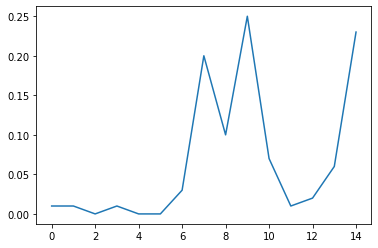

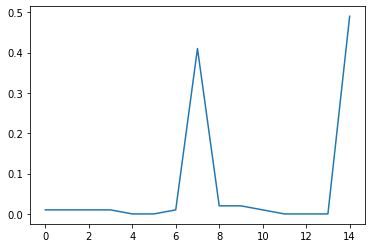

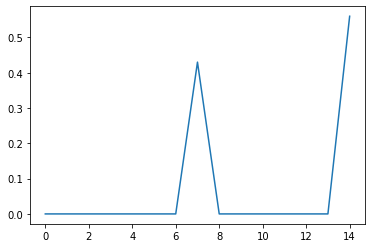

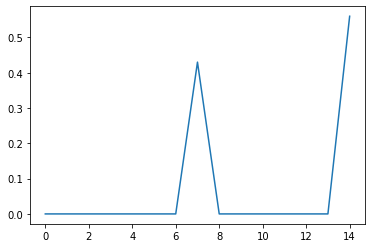

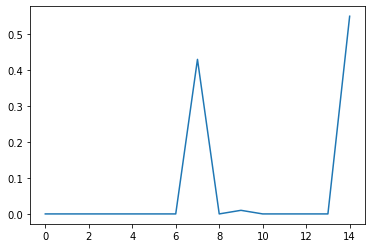

...

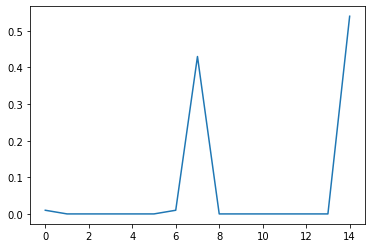

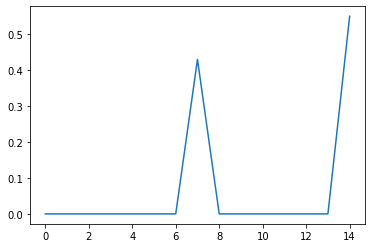

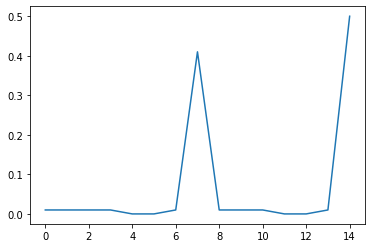

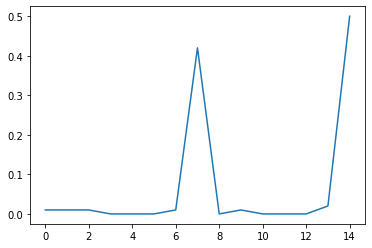

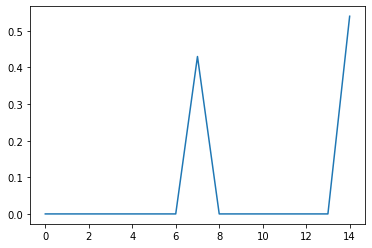

In [ ]:
fig = plt.figure()
fig.subplots_adjust(hspace=0.4, wspace=0.4)
for i in range(0,15):
  plt.plot(attn_val[i]) 
  plt.show()



In [ ]:
last_layer_head0 = attention[-1][0][0].cpu().detach().numpy()
attn_val = np.around(last_layer_head0, decimals=2)

In [ ]:
attn_val.shape

(73, 73)

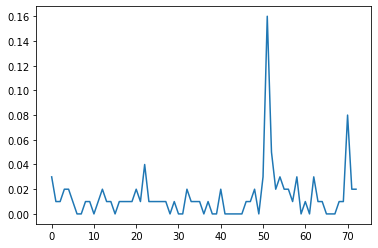

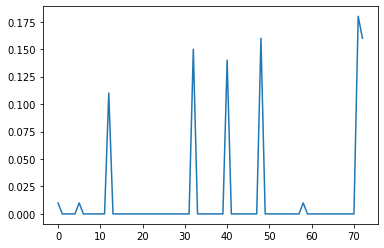

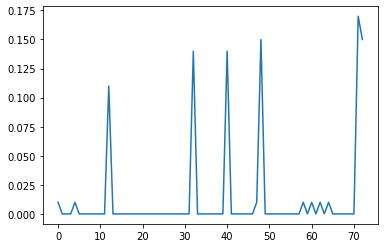

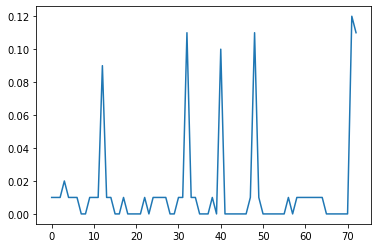

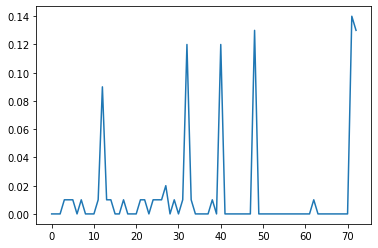

...

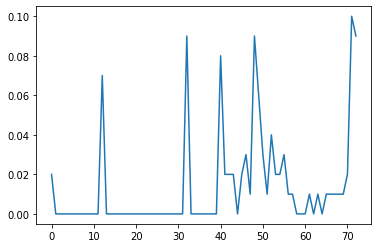

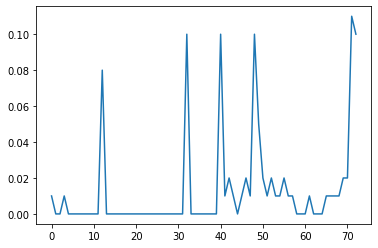

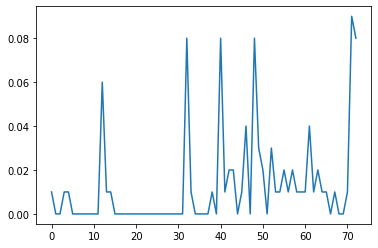

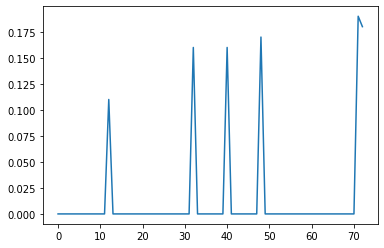

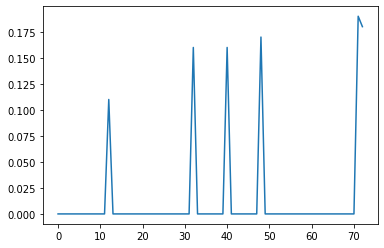

In [ ]:
fig = plt.figure()
fig.subplots_adjust(hspace=0.4, wspace=0.4)
for i in range(0,73):
  plt.plot(attn_val[i]) 
  plt.show()

In [ ]:
sentence_a = "CSF levels of HVA, 5-HIAA, and free MHPG, the major metabolites of dopamine, serotonin, and norepinephrine respectively, were measured in 22 patients with AD."
sentence_b = "These 22 patients were also administered tests of picture-recognition and attentional focusing as part of an earlier experiment."

inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt', add_special_tokens=True)
token_type_ids = inputs['token_type_ids']
input_ids = inputs['input_ids']
attention = model(input_ids, token_type_ids=token_type_ids)[-1]
input_id_list = input_ids[0].tolist() # Batch index 0
tokens = tokenizer.convert_ids_to_tokens(input_id_list)
call_html()

head_view(attention, tokens)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
attention[-1][0][0].cpu().detach().numpy()